# Projet de Deep Learning : 
## Colorisation d'images en niveaux de gris

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Projet mené par Oriane Longeron et Killian Heim.

</div>

## Imports

In [141]:
import numpy as np
import matplotlib.pyplot as plt

import cv2

# Sauvegarde et récupération des ensembles de données
import pickle

# Dé-zipper un .zip
from zipfile import ZipFile

# Suivi de l'exécution d'une boucle
from tqdm import tqdm

import os
import shutil
import random

from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import requests

from keras.callbacks import ModelCheckpoint, EarlyStopping

## Chargement des sets enregistrés

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

La base de donnée étant conséquente (donc trop lourde pour envoi), nous avons préparé les ensembles d'entraînement, de validation et de test (les cellules qui concernent la section *préparation des données* **ne sont pas à exécuter**) et nous les avons enregistrées dans un fichier de données *`sets.pkl`*. Le code qui suit permet de récupérer ces ensembles de données.

</div>

In [221]:
with open("sets.pkl", "rb") as f:
    data = pickle.load(f)

X_train = data["X_train"] # entrées
Y_train = data["Y_train"] # cibles

X_val = data["X_val"]
Y_val = data["Y_val"]

X_test = data["X_test"]
Y_test = data["Y_test"]

pred = data["pred"]



with open("sets_Lab.pkl", "rb") as f:
    data = pickle.load(f)

X_train_Lab = data["X_train_Lab"] # entrées
Y_train_Lab = data["Y_train_Lab"] # cibles

X_val_Lab = data["X_val_Lab"]
Y_val_Lab = data["Y_val_Lab"]

X_test_Lab = data["X_test_Lab"]
Y_test_Lab = data["Y_test_Lab"]

pred_Lab = data["pred_Lab"]



with open("sets_YCbCr.pkl", "rb") as f:
    data = pickle.load(f)

X_train_YCbCr = data["X_train_YCbCr"] # entrées
Y_train_YCbCr = data["Y_train_YCbCr"] # cibles

X_val_YCbCr = data["X_val_YCbCr"]
Y_val_YCbCr = data["Y_val_YCbCr"]

X_test_YCbCr = data["X_test_YCbCr"]
Y_test_YCbCr = data["Y_test_YCbCr"]

pred_YCbCr = data["pred_YCbCr"]



with open("sets_CelebA.pkl", "rb") as f:
    data = pickle.load(f)

pred_CelebA = data["pred_CelebA"]

## Premières pistes

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On utilise la base de données Raise1K qui contient 1000 images de contextes variés. L'ensemble des données est de petite taille mais suffisamment grand pour un projet de moyenne envergure. <br>
Nous avons utilisé 70% des images pour l'entrainement et 15% des images pour la validation. Les images restantes sont utilisées pour le test.

</div>

### Préparation des données

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Les entrées de notre modèle seront des images en niveaux de gris et les cibles seront les images en couleurs.

On créé une fonction de *preprocess* pour les entrées et les cibles :

</div>

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Dans le cas des *entrées* les images sont :
- redimensionnées en 256x256 (pour que toutes les images aient la même tailles),
- converties en niveaux de gris (tout en ajoutant la dimension du canal pour que la forme soit compatible avec les entrées du modèle),
- normalisées (pour améliorer la convergence du modèle)

</div>

In [2]:
def preprocess_entree(image, target_size=(256, 256)):

    # Redimensionnement
    resized_image = cv2.resize(image, target_size)

    # Convertion en niveaux de gris
    gray_image = cv2.cvtColor(resized_image, cv2.COLOR_RGB2GRAY)

    # On ajoute la dimension du canal (pour avoir la forme [256, 256, 1])
    gray_image = np.expand_dims(gray_image, axis=-1)

    # Normalisation des pixels de 0 à 1
    gray_image = gray_image / 255.0

    return gray_image

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Dans le cas des *cibles* les images sont :
- redimensionnées en 256x256 (pour que toutes les images aient la même tailles),
- normalisées (pour améliorer la convergence du modèle)

</div>

In [3]:
def preprocess_target(image, target_size=(256, 256)):

    # Redimensionnement
    resized_image = cv2.resize(image, target_size)

    # Normalisation des pixels de 0 à 1
    color_image = resized_image / 255.0
    
    return color_image

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On décompresse le fichier `'RAISE1K'` d'images en couleurs et on sépare les 1000 images aléatoirement en trois sous-dossiers : `train`, `val`, `test`.

</div>

In [4]:
# Fonction pour déplacer les images vers les bons dossiers
def move_images(source_folder, image_list, destination_folder):

    with tqdm(image_list, desc=f"Création de {destination_folder}", unit="image") as pbar:

        for image in pbar:
            
            source_path = os.path.join(source_folder, image)
            destination_path = os.path.join(destination_folder, image)
            shutil.move(source_path, destination_path)

In [5]:
def extract_zip_separate(zip_path, extract_to=''):

    # Exctraction du zip dans le même dossier
    with ZipFile(zip_path + ".zip", 'r') as zip_ref:
        zip_ref.extractall(extract_to)

    print(f"Fichiers extraits")

    # noms des dossiers
    train_folder = zip_path + "/train"
    val_folder = zip_path + "/val"
    test_folder = zip_path +"/test"
    
    # Création des sous-dosiers si nécessaires
    os.makedirs(train_folder, exist_ok=True)
    os.makedirs(val_folder, exist_ok=True)
    os.makedirs(test_folder, exist_ok=True)

    all_images = [f for f in os.listdir(zip_path) if os.path.isfile(os.path.join(zip_path, f))]
    total_images = len(all_images)
    
    # Tailles des sous-ensembles (70%, 15%, 15%)
    train_size = int(total_images * 0.7)
    val_size = int(total_images * 0.15)
    test_size = total_images - train_size - val_size

    # Mélange aléatoire des images
    random.seed(5)
    random.shuffle(all_images)

    # Divison en trois ensembles
    train_images = all_images[:train_size]
    val_images = all_images[train_size:train_size + val_size]
    test_images = all_images[train_size + val_size:train_size + val_size + test_size]

    # Déplacer les images vers les dossiers correspondants
    move_images(zip_path, train_images, train_folder)
    move_images(zip_path, val_images, val_folder)
    move_images(zip_path, test_images, test_folder)

    print(f"Images réparties")

In [15]:
extract_zip_separate("RAISE1K")

Fichiers extraits


Création de RAISE1K/test: 100%|██████████| 150/150 [00:00<00:00, 1026.23image/s]

Images réparties


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

A ce niveau on a les images dans trois sous-dossiers : `train`, `val`, `test`.

On va maintenant créer les ensembles `X_train`, `Y_train`, `X_val`, `Y_val`, `X_test`, `Y_test`.
</div>

In [6]:
# Fonction pour obtenir toutes les images dans un dossier
def get_image_list(folder_path):
    
    images = []  

    for filename in os.listdir(folder_path):

        file_path = os.path.join(folder_path, filename)

        if os.path.isfile(file_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):

            img = cv2.imread(file_path)  # Chargement de l'image en BGR

            if img is not None:
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Conversion en RGB
                images.append(img_rgb)
                
    return images

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_train`, `Y_train` :

</div>

In [7]:
train = get_image_list("RAISE1K/train")
X_train = []
Y_train = []

with tqdm(train, desc="Création de X_train et Y_train", unit="image") as pbar:
    
    for image in pbar:
        X_train.append(preprocess_entree(image))
        Y_train.append(preprocess_target(image))

X_train = np.array(X_train)
Y_train = np.array(Y_train)

Création de X_train et Y_train: 100%|██████████| 700/700 [00:01<00:00, 601.95image/s]


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_val`, `Y_val` :

</div>

In [8]:
val = get_image_list("RAISE1K/val")
X_val = []
Y_val = []

with tqdm(val, desc="Création de X_val et Y_val", unit="image") as pbar:
    
    for image in pbar:
        X_val.append(preprocess_entree(image))
        Y_val.append(preprocess_target(image))

X_val = np.array(X_val)
Y_val = np.array(Y_val)

Création de X_val et Y_val: 100%|██████████| 150/150 [00:00<00:00, 713.30image/s]


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_test`, `Y_test` :

</div>

In [9]:
test = get_image_list("RAISE1K/test")
X_test = []
Y_test = []

with tqdm(test, desc="Création de X_test et Y_test", unit="image") as pbar:
    
    for image in pbar:
        X_test.append(preprocess_entree(image))
        Y_test.append(preprocess_target(image))

X_test = np.array(X_test)
Y_test = np.array(Y_test)

Création de X_test et Y_test: 100%|██████████| 150/150 [00:00<00:00, 519.43image/s]


### Quelques exemples d'images 

In [10]:
def show_examples(imgs, title=''):
    """
    Plots d'ig images dans une grille numx10.
    
    Args:
        images (list): Liste des images.
    """
    if len(imgs) % 5 != 0:
        raise ValueError("La liste doit être de longueur un multiple de 5.")
    
    fig, axes = plt.subplots(len(imgs) // 5, 5, figsize=(15, int(0.7 * len(imgs))))
    axes = axes.ravel()  # Applati la grille 2D en un tableau 1D
    
    for i in range(len(imgs)):
        
        axes[i].imshow(imgs[i], cmap='gray')
        axes[i].axis('off')
   
    fig.suptitle(title)
    plt.tight_layout()
    plt.show()

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On affiche quelques exemples des images de la base de données :

</div>

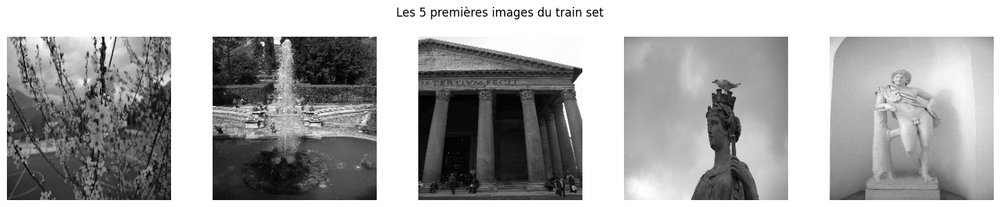

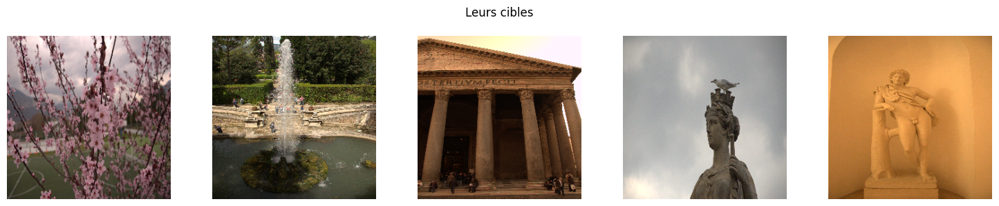

In [11]:
show_examples(X_train[:5], "Les 5 premières images du train set")
show_examples(Y_train[:5], "Leurs cibles")

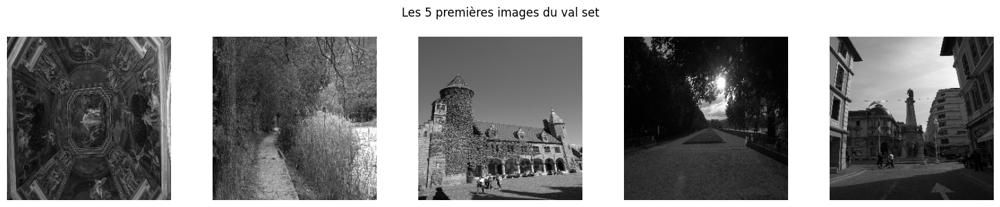

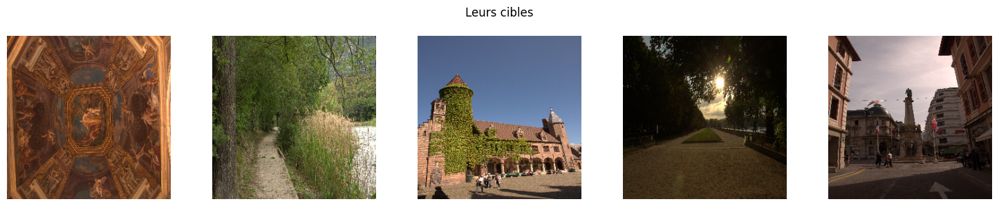

In [12]:
show_examples(X_val[:5], "Les 5 premières images du val set")
show_examples(Y_val[:5], "Leurs cibles")

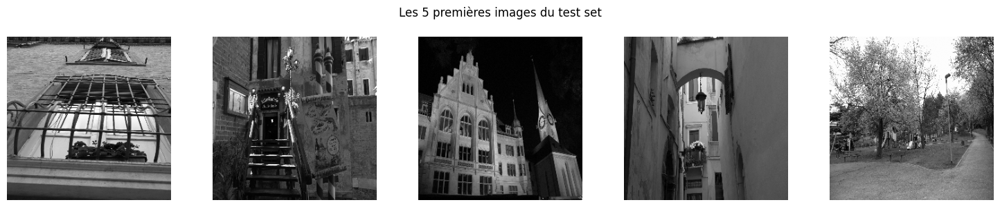

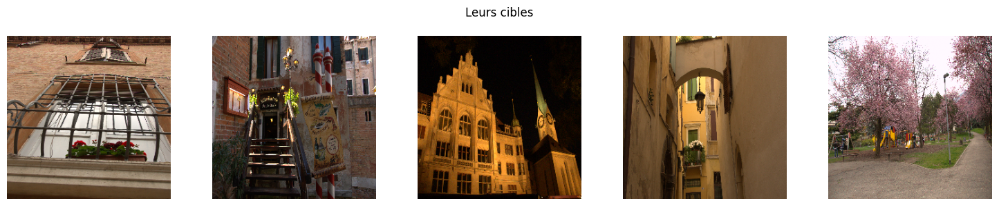

In [13]:
show_examples(X_test[:5], "Les 5 premières images du test set")
show_examples(Y_test[:5], "Leurs cibles")

## Un premier modèle simple : Autoencodeur convolutionnel

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Nous avons vu en cours que les réseaux de neurones convolutionnels (CNN) sont bien adaptés aux problèmes de traitement d'image car ils sont spécifiquement conçus pour traiter des données structurées en deux ou trois dimensions. 

De plus, les images possèdent une structure spatiale où les pixels proches partagent souvent des informations contextuelles et les convolutions, utilisées dans les CNN, permettent de capturer cette information en exploitant les relations locales entre les pixels. Cette caractéristique des CNN est utile pour la colorisation d'images car la couleur d'un pixel peut avoir un lien avec la couleur des pixels voisins en fonction du contexte : par exemple, un pixel gris dans une région "ciel" sera probablement coloré en bleu, ce qui dépend du contexte spatial capturé par un CNN.

Cette caractéristique, ainsi que les opérations de pooling qui réduisent la taille tout en conservant l'essentiel de l'information, permettront une compréhension du contexte global pour choisir des couleurs cohérentes (par exemple, le ciel est souvent bleu) et de conserver les détails fins pour éviter une colorisation floue ou incohérente.

Nous réalisons donc un autoencodeur convolutionnel pour reconstruire les images en couleurs à partir des images en niveaux de gris.

</div>

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

L'encodeur va réduire progressivement la taille de l'image tout en extrayant des caractéristiques importantes :

</div>

In [115]:
encoder = models.Sequential([

    layers.InputLayer(shape=(256, 256, 1)), # Les images sont de taille (256, 256) avec 1 canal (niveaux de gris).
    layers.Conv2D(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(256, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    # Couche de "bottleneck"
    layers.Conv2D(512, kernel_size=(3, 3), padding="same", activation="relu")
])

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Le décodeur va augmenter progressivement la taille de l'image pour revenir à 256x256x3 (image colorée) :

</div>

In [116]:
decoder = models.Sequential([
    layers.Conv2DTranspose(256, kernel_size=(3, 3), padding="same", activation="relu", input_shape=[16, 16, 512]),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    # Dernière couche pour reconstruire l'image en couleur (3 canaux)
    layers.Conv2DTranspose(3, kernel_size=(3, 3), padding="same", activation="sigmoid")
])

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Et on créé l'autoencodeur :

</div>

In [117]:
stacked_autoencoder = models.Sequential([encoder, decoder])

In [118]:
stacked_autoencoder.summary()

Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_25 (Sequential)      │ (None, 16, 16, 512)    │     1,568,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_26 (Sequential)      │ (None, 256, 256, 3)    │     1,568,067 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,136,067 (11.96 MB)

 Trainable params: 3,136,067 (11.96 MB)

 Non-trainable params: 0 (0.00 B)

In [119]:
stacked_autoencoder.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

In [120]:
batch_size = 50
ntrain = len(X_train)
nval = len(X_val)

train_datagen = ImageDataGenerator() 
val_datagen = ImageDataGenerator() # On ne fait pas d'augmentation

#On créé les générateurs d'images
train_generator = train_datagen.flow(X_train, Y_train, batch_size=batch_size)
val_generator = val_datagen.flow(X_val, Y_val, batch_size=batch_size)

### Entrainement du modèle

In [121]:
history = stacked_autoencoder.fit(train_generator,
                                steps_per_epoch=ntrain // batch_size,
                                epochs=100,
                                validation_data=val_generator,
                                validation_steps=nval // batch_size)

Epoch 1/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 39s 3s/step - accuracy: 0.4928 - loss: 0.0776 - val_accuracy: 0.7010 - val_loss: 0.0593
Epoch 2/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.6726 - loss: 0.0498 - val_accuracy: 0.6997 - val_loss: 0.0299
Epoch 3/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - accuracy: 0.5737 - loss: 0.0275 - val_accuracy: 0.7007 - val_loss: 0.0237
Epoch 4/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.6699 - loss: 0.0226 - val_accuracy: 0.7005 - val_loss: 0.0206
Epoch 5/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.6705 - loss: 0.0200 - val_accuracy: 0.6453 - val_loss: 0.0189
Epoch 6/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.6146 - loss: 0.0189 - val_accuracy: 0.6740 - val_loss: 0.0176
Epoch 7/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.6456 - loss: 0.0172 - val_accuracy: 0.6905 - val_loss: 0.0172
Epoch 8/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.6547 - loss: 0.0172 - val_accuracy: 0.6862 - v

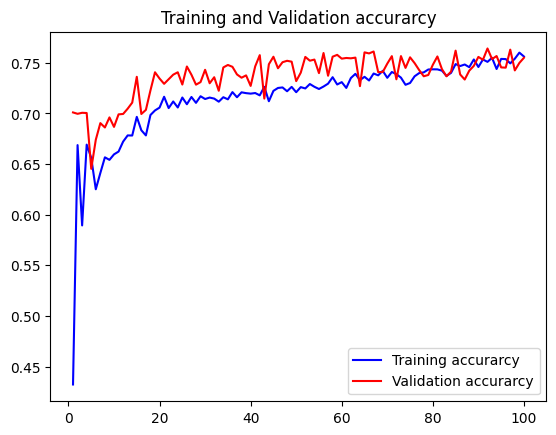

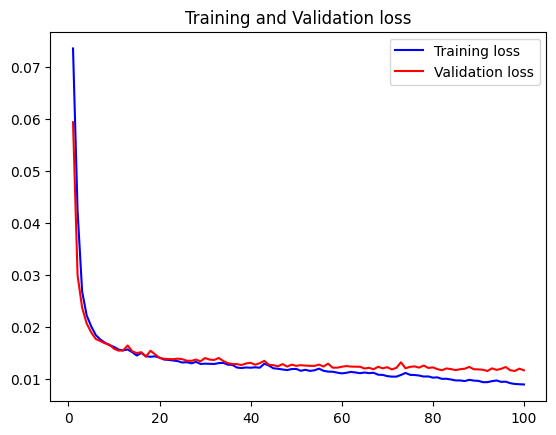

In [122]:
#lets plot the train and val curve
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.title('Training and Validation accurarcy')
plt.legend()
plt.figure()

#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and Validation loss')
plt.legend()
plt.show()

### Sauvegarde du modèle

In [123]:
stacked_autoencoder.save('stacked_autoencoder.keras')

### Prédictions sur l'ensemble de test

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On fait des prédictions sur l'ensemble de test :

</div>

In [124]:
test_datagen = ImageDataGenerator()
pred = []

for i, batch in enumerate(test_datagen.flow(X_test, batch_size=1, shuffle=False)):
    pred.append(stacked_autoencoder.predict(batch))

    # Stopper la boucle lorsque toutes les images ont été traitées
    if i >= len(X_test) - 1:
        break

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━

In [125]:
pred = [np.squeeze(pred[k], axis=0) for k in range(len(pred))]

### Enregistrement des sets et des pred

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Comme évoqué précédemment, on enregistre les ensembles que l'on vient de construire dans le fichier *`sets.pkl`* :

</div>

In [126]:
# data = {"X_train": X_train, "Y_train": Y_train,
#         "X_val": X_val, "Y_val": Y_val,
#         "X_test": X_test, "Y_test": Y_test,
#         "pred": pred}

# with open("sets.pkl", "wb") as f:
#     pickle.dump(data, f)

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On affiche quelques résultats :

</div>

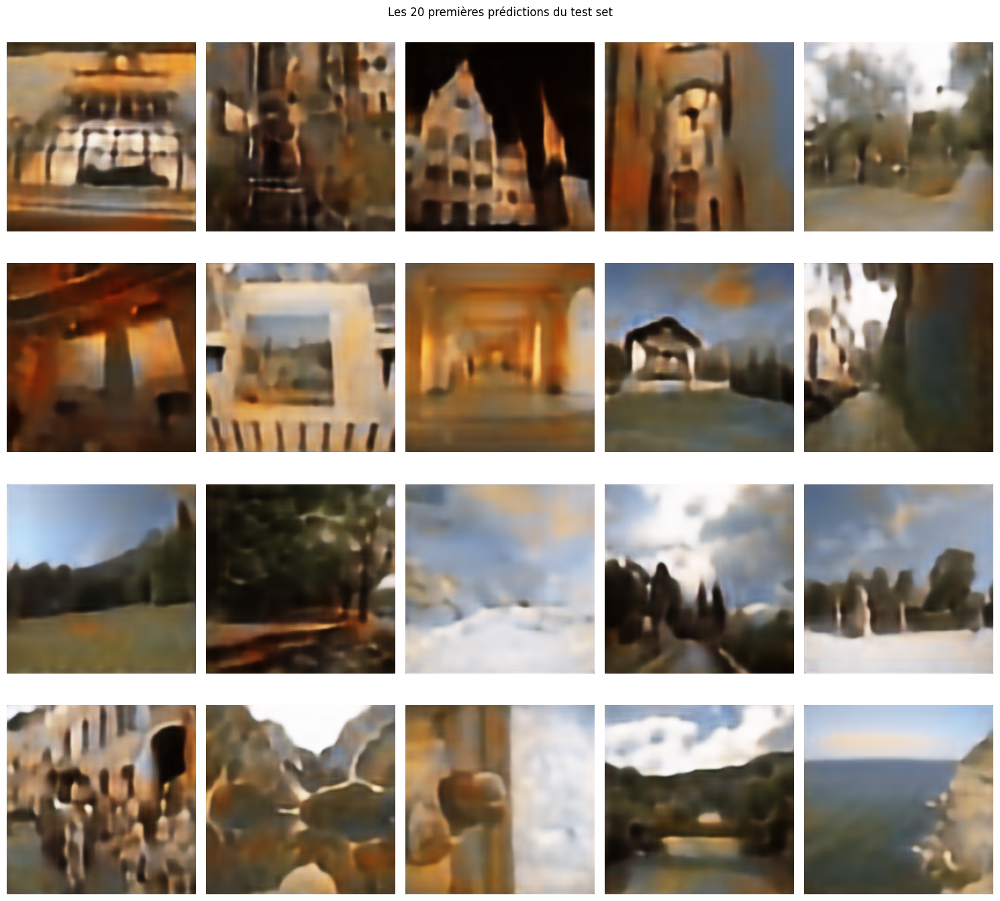

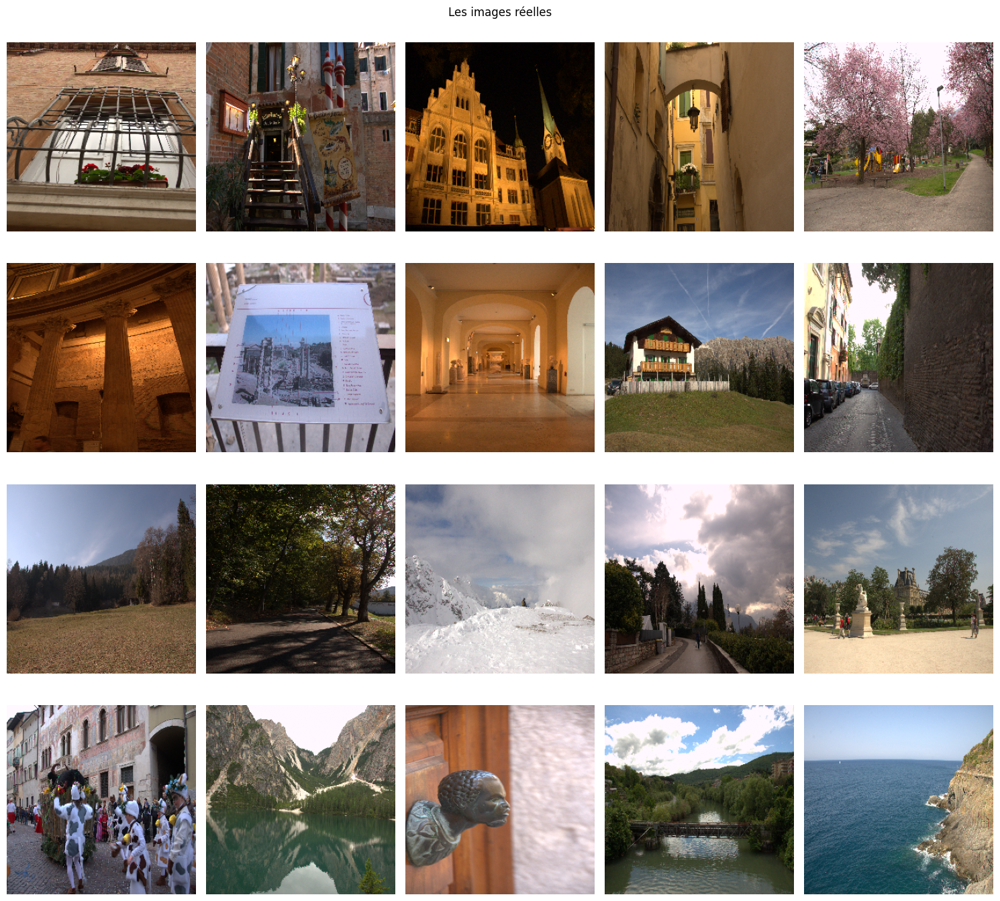

In [142]:
show_examples(pred[:20], "Les 20 premières prédictions du test set")
show_examples(Y_test[:20], "Les images réelles")

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Le résultat est globalement assez flou. On remarque que les grandes zones claires de l'image, souvent associées au ciel, ont été colorisées en bleu, ce qui montre que le modèle a appris certaines associations de couleurs basées sur les motifs présents dans les données. Mais le modèle a surtout retenu les grandes caractéristiques globales, sans conserver les détails fins, comme les contours ou les nuances plus subtiles de l'image. Nous observons aussi des artéfactes de couleurs.

Le résultat final manque de précision et semble trop simplifié.

</div>

## Piste d'amélioration : Changement d'espace colorimétrique [RGB $\to$ LAB]

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Dans le modèle précédent, nous nous trouvons dans l'espace RGB. Les informations de luminance sont donc mélangées aux informations portées par les chrominances. Dans l'espace colorimétrique Lab, nous travaillons avec un espace de couleur où les informations sont séparées en trois composantes distinctes : L* (luminance), a* (chrominance verte-rouge) et b* (chrominance bleue-jaune).

- Luminance L* : la composante L* représente directement la luminosité de l'image, de 0 (noir) à 100 (blanc). Cela permet de décrire l'éclat ou l'intensité lumineuse sans tenir compte de la couleur, ce qui facilite des traitements de luminance indépendants des couleurs elles-mêmes.

- Composante a* : Cette composante mesure l'axe de la couleur entre le vert et le rouge. Elle va de -128 (vert) à +128 (rouge). La composante a* est donc un indicateur de la quantité de rouge et de vert dans l'image, sans mélanger ces informations avec la luminance.

- Composante b* : De manière similaire à a*, la composante b* mesure l'axe de couleur entre le bleu et le jaune. Elle varie également de -128 (bleu) à +128 (jaune), permettant de quantifier la quantité de bleu ou de jaune dans une image.

En sachant que la luminance et les chrominance contiennent des informations distinctes, on peut imaginer que prédire les composantes a* et b* (les composantes chromatiques) plutôt que directement dans le domaine RGB pourrait conduire à de meilleurs résultats.<br>
Comme la majorité des informations importantes sur la structure d'une image (les formes, les contours, les textures) sont contenues dans la composante L*, concervation de la luminance intacte conduirait déjà à des résultats moins flous. Cela éviterait au modèle de perdre de l'information critique tout en ajustant les couleurs avec plus de flexibilité.

</div>

### Nouveau traitement des images

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On réalise une nouvelle fonction de preprocess des données, séparant les différentes composantes.

</div>

In [185]:
def preprocess(image_path, target_size=(256, 256)):

    # Chargement de l'image
    image = cv2.imread(image_path)

    # Redimensionnement
    image = cv2.resize(image, target_size)

    # Convertion en espace YCbCr
    image_lab = cv2.cvtColor(image, cv2.COLOR_BGR2Lab)
    L_channel, a_channel, b_channel = cv2.split(image_lab)

    # Normalisation des valeurs entre 0 et 1
    # Lors de la conversion d'images 8 bits, la plage de L est multipliée par 255/100, et a et b reçoivent un décalage de 128 pour remplir la plage 8 bits.
    L_channel = L_channel / 255.0 # Version noir et blanc de l'image, donc l'entrée du modèle
    # En soustrayant 128 et en divisant par 128, on centre les valeurs autour de 0 et on les réduit à l'échelle [-1, 1]. 
    # Cela équilibre l'importance des valeurs positives (teintes chaudes ou vertes) et négatives (teintes froides ou rouges).
    a_channel = (a_channel - 128.0) / 128.0 
    b_channel = (b_channel - 128.0) / 128.0

    # On ajoute la dimension du canal (pour avoir la forme [256, 256, 1])
    L_channel = np.expand_dims(L_channel, axis=-1)

    return L_channel, np.stack((a_channel, b_channel), axis=-1) 

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

La luminance L* est l'image en noir et blanc. Elle contient tous les contours et détails nécessaires pour identifier les objets dans l'image. C'est l'entrée du modèle.

On créé des nouveaux ensembles de données :

</div>

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_train_Lab`, `Y_train_Lab` :

</div>

In [186]:
folder_path = "RAISE1K/train"
X_train_Lab = []
Y_train_Lab = []

with tqdm(os.listdir(folder_path), desc="Création de X_train_Lab et Y_train_Lab", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_train_Lab.append(X)
        Y_train_Lab.append(Y)

X_train_Lab = np.array(X_train_Lab)
Y_train_Lab = np.array(Y_train_Lab)

Création de X_train_Lab et Y_train_Lab: 100%|██████████| 700/700 [10:56<00:00,  1.07image/s] 


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_val_Lab`, `Y_val_Lab` :

</div>

In [187]:
folder_path = "RAISE1K/val"
X_val_Lab = []
Y_val_Lab = []

with tqdm(os.listdir(folder_path), desc="Création de X_val_Lab et Y_val_Lab", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_val_Lab.append(X)
        Y_val_Lab.append(Y)

X_val_Lab = np.array(X_val_Lab)
Y_val_Lab = np.array(Y_val_Lab)

Création de X_val_Lab et Y_val_Lab:   0%|          | 0/150 [00:00<?, ?image/s]

Création de X_val_Lab et Y_val_Lab: 100%|██████████| 150/150 [01:25<00:00,  1.76image/s]


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_test_Lab`, `Y_test_Lab` :

</div>

In [188]:
folder_path = "RAISE1K/test"
X_test_Lab = []
Y_test_Lab = []

with tqdm(os.listdir(folder_path), desc="Création de X_test_Lab et Y_test_Lab", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_test_Lab.append(X)
        Y_test_Lab.append(Y)

X_test_Lab = np.array(X_test_Lab)
Y_test_Lab = np.array(Y_test_Lab)

Création de X_test_Lab et Y_test_Lab: 100%|██████████| 150/150 [01:29<00:00,  1.68image/s]


### Un second modèle

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Ce modèle change essentiellement au niveau de la couche de sortie car l'espace de représentation des couleurs n'est plus le même.

</div>

In [196]:
encoder = models.Sequential([

    layers.InputLayer(shape=(256, 256, 1)), # Les images sont de taille (256, 256) avec 1 canal (niveaux de gris).
    layers.Conv2D(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(256, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    # Couche de "bottleneck"
    layers.Conv2D(512, kernel_size=(3, 3), padding="same", activation="relu")
])

In [197]:
decoder = models.Sequential([
    layers.Conv2DTranspose(256, kernel_size=(3, 3), padding="same", activation="relu", input_shape=[16, 16, 512]),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    # Dernière couche 
    layers.Conv2DTranspose(2, kernel_size=(3, 3), padding="same", activation="tanh") # tanh car maintenant les valeurs sont comprises entre -1 et 1
])

In [198]:
stacked_autoencoder_Lab = models.Sequential([encoder, decoder])

In [199]:
stacked_autoencoder_Lab.summary()

Model: "sequential_44"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_42 (Sequential)      │ (None, 16, 16, 512)    │     1,568,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_43 (Sequential)      │ (None, 256, 256, 2)    │     1,567,778 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,135,778 (11.96 MB)

 Trainable params: 3,135,778 (11.96 MB)

 Non-trainable params: 0 (0.00 B)

In [200]:
stacked_autoencoder_Lab.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

In [201]:
batch_size = 50
ntrain = len(X_train_Lab)
nval = len(X_val_Lab)

train_datagen = ImageDataGenerator() 
val_datagen = ImageDataGenerator() # On ne fait pas d'augmentation

#On créé les générateurs d'images
train_generator = train_datagen.flow(X_train_Lab, Y_train_Lab, batch_size=batch_size)
val_generator = val_datagen.flow(X_val_Lab, Y_val_Lab, batch_size=batch_size)

### Entraînement du modèle

In [210]:
hist_lab = []

In [212]:
history = stacked_autoencoder_Lab.fit(train_generator,
                                steps_per_epoch=ntrain // batch_size,
                                epochs=50,
                                validation_data=val_generator,
                                validation_steps=nval // batch_size)

Epoch 1/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 82s 6s/step - accuracy: 0.7492 - loss: 0.0072 - val_accuracy: 0.7317 - val_loss: 0.0086
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 76s 5s/step - accuracy: 0.7595 - loss: 0.0068 - val_accuracy: 0.7334 - val_loss: 0.0089
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 76s 5s/step - accuracy: 0.7711 - loss: 0.0070 - val_accuracy: 0.7312 - val_loss: 0.0085
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 78s 6s/step - accuracy: 0.7600 - loss: 0.0065 - val_accuracy: 0.7337 - val_loss: 0.0082
Epoch 5/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 89s 6s/step - accuracy: 0.7626 - loss: 0.0069 - val_accuracy: 0.7158 - val_loss: 0.0084
Epoch 6/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 93s 7s/step - accuracy: 0.7501 - loss: 0.0076 - val_accuracy: 0.7329 - val_loss: 0.0085
Epoch 7/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 84s 6s/step - accuracy: 0.7585 - loss: 0.0068 - val_accuracy: 0.7362 - val_loss: 0.0088
Epoch 8/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 88s 6s/step - accuracy: 0.7615 - loss: 0.0069 - val_accuracy: 0.7370 - val_loss:

In [213]:
hist_lab.append(history.history)

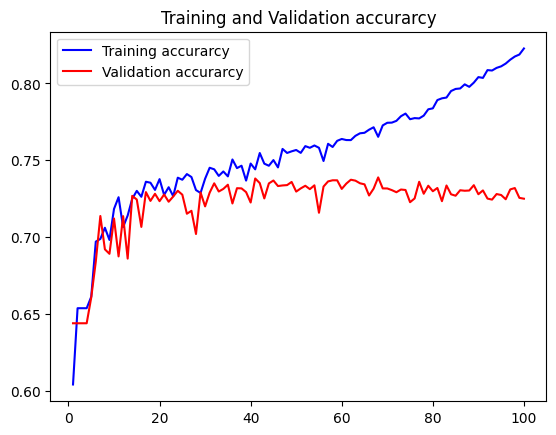

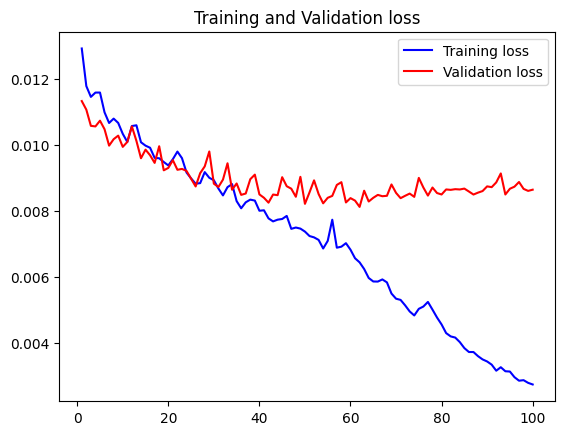

In [214]:
acc = []
val_acc =[]
loss = []
val_loss = []
for history in hist_lab:
    acc.extend(history['accuracy'])
    val_acc.extend(history['val_accuracy'])
    loss.extend(history['loss'])
    val_loss.extend(history['val_loss'])

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.title('Training and Validation accurarcy')
plt.legend()
plt.figure()

#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and Validation loss')
plt.legend()
plt.show()

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On observe une bonne évolution de l'accuracy et de la loss pour l'ensemble d'entraînement. <br>
Cependant, la précision de validation stagne autour de 0.70-0.75 après environ 20 époques. <br>
Cette stagnation, combinée à une augmentation continue de la précision d'entraînement, indique que le modèle pourrait commencer à sur-apprendre (overfitting) les données d'entraînement. <br>
En ce qui concerne la loss, après une diminution initiale la loss de validation stagne, voire fluctue légèrement (environ après 20 époques). <br>
Cela pourrait suggérer que le modèle atteint une limite de performance avec les données actuelles.

</div>

### Sauvegarde du modèle

In [215]:
stacked_autoencoder_Lab.save('stacked_autoencoder_Lab.keras')

### Prédictions sur l'ensemble de test

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On fait des prédictions sur l'ensemble de test : 

</div>

In [216]:
test_datagen = ImageDataGenerator()
pred_Lab = []

for i, batch in enumerate(test_datagen.flow(X_test_Lab, batch_size=1, shuffle=False)):
    pred_Lab.append(stacked_autoencoder_Lab.predict(batch))

    # Stopper la boucle lorsque toutes les images ont été traitées
    if i >= len(X_test_Lab) - 1:
        break

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On reconstruit les images (passage de LAB vers RGB) :

</div>

In [217]:
pred_Lab = [np.squeeze(pred_Lab[k], axis=0) for k in range(len(pred_Lab))]

In [218]:
n = 0

with tqdm(pred_Lab, desc="Reconstruction", unit="image") as pbar:
    for prediction in pbar:

        a_reconstructed = np.expand_dims(((prediction[:,:,0] * 128) + 128).astype(np.uint8), axis=-1)
        b_reconstructed = np.expand_dims(((prediction[:,:,1] * 128) + 128).astype(np.uint8), axis=-1)
        L_reconstructed = (X_test_Lab[n] * 255).astype(np.uint8)

        # Recombinaison des canaux
        image_lab_pred = cv2.merge([L_reconstructed, a_reconstructed, b_reconstructed])

        # Convertion en RGB
        image_rgb_pred = cv2.cvtColor(image_lab_pred, cv2.COLOR_LAB2RGB)

        pred_Lab[n] = image_rgb_pred

        n += 1

Reconstruction: 100%|██████████| 150/150 [00:00<00:00, 236.66image/s]


### Enregistrement des nouveaux sets et prédictions

In [219]:
# data = {"X_train_Lab": X_train_Lab, "Y_train_Lab": Y_train_Lab,
#         "X_val_Lab": X_val_Lab, "Y_val_Lab": Y_val_Lab,
#         "X_test_Lab": X_test_Lab, "Y_test_Lab": Y_test_Lab,
#         "pred_Lab": pred_Lab}

# with open("sets_Lab.pkl", "wb") as f:
#     pickle.dump(data, f)

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On affiche quelques résultats :

</div>

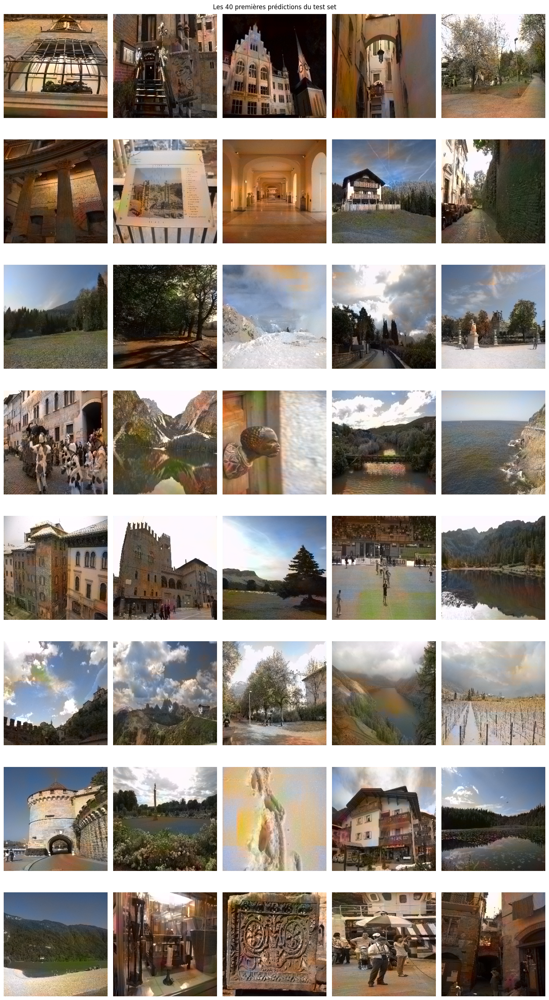

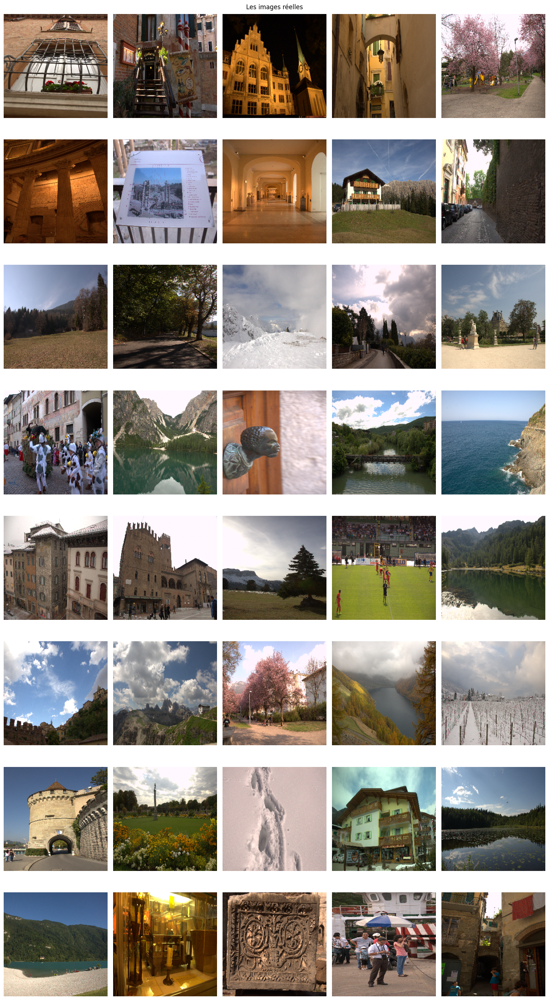

In [220]:
show_examples(pred_Lab[:40], "Les 40 premières prédictions du test set")
show_examples(Y_test[:40], "Les images réelles")

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

En examinant ce rendu, plusieurs observations et conclusions peuvent être tirées :

Les résultats montrent que le modèle parvient à coloriser les images, mais les couleurs semblent parfois diffuses, avec des artefacts ou des teintes non réalistes dans certaines zones. Mais la structure des objets dans les images est tout de même respectée, ce qui indique que le modèle comprend globalement la forme et les contours des objets.

Néanmoins, comme dit précédemment, certaines régions présentent des couleurs peu naturelles ou trop saturées (par exemple, des bandes de couleur orange ou verte dans des zones où elles ne devraient pas être présentes). Cela peut suggérer que le modèle a du mal à comprendre le contexte global des scènes et génère des couleurs de manière localement incohérente.

Une explication possible pourrait se trouver dans la qualité de la base de données. Si les données d'entraînement ne sont pas bien équilibrées en termes de diversité (types de scènes, variations de lumière, etc.), le modèle peut produire des résultats biaisés. Les bandes de couleurs observées peuvent aussi être dues à des limitations dans la diversité des exemples d'entraînement. Peut-être que RAISE1K n'est pas une base de données adaptée à un problème de recolorisation.

RAISE1K est une base de données qui contient essentiellement des paysages et quelques images d'un autre type. On remarque, de ce fait, que les images comportant des paysages sont généralement mieux colorisées que les autres (moins d'artéfactes de couleur et plus de cohérence dans les couleurs). L'idéal serait donc soit d'avoir une base de données très équilibrée présentant diverses contextes mais de manière bien répartie, soit une base de données très spécifique, avec un contexte bien particulier (des portraits par exemple) de manière a spécifier le modèle sur une tâche. Intuitivement, ces deux choix permettraient une meilleure généralisation des résultats. Mais, dans l'idéal, il est tout de même préférable de choisir une base de données contenant plein de contextes différents pour obtenir un modèle efficace dans plusieurs contextes et non limité à un contexte spécifique.

</div>

## Essais avec l'espace colorimétrique YCrCb

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Dans l'espace YCrCb

- La luminance Y représente la quantité de lumière qui est perçue sans tenir compte de la couleur. Elle est généralement dérivée de la combinaison des trois canaux RGB  en prenant en compte la perception humaine de la lumière (par exemple, l'oeil humain est plus sensible au vert). C'est pourquoi le canal Y est souvent le plus important et celui qui conserve le plus d'informations visuelles.
- La chrominance Cb représente la différence entre la composante bleu et la luminance. C'est un indicateur de la quantité de bleu dans l'image. Elle est calculé comme la différence entre le bleu et la luminance : Cb = B - Y.
- La chrominance Cr représente la différence entre la composante rouge et la luminance. C'est un indicateur de la quantité de rouge dans l'image. Elle est calculé comme la différence entre le rouge et la luminance : Cr = R - Y.

</div>

### Nouveau traitement des images

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On réalise une nouvelle fonction de preprocess des données, séparant les différentes composantes.

</div>

In [52]:
def preprocess(image_path, target_size=(256, 256)):

    # Chargement de l'image
    image = cv2.imread(image_path)

    # Redimensionnement
    image = cv2.resize(image, target_size)

    # Convertion en espace YCbCr
    image_ycbcr = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
    Y_channel, Cr_channel, Cb_channel = cv2.split(image_ycbcr)

    # Normalisation des valeurs entre 0 et 1
    Y_channel = Y_channel / 255.0 # Version noir et blanc de l'image, donc l'entrée du modèle
    Cr_channel = Cr_channel / 255.0
    Cb_channel = Cb_channel / 255.0

    # On ajoute la dimension du canal (pour avoir la forme [256, 256, 1])
    Y_channel = np.expand_dims(Y_channel, axis=-1)

    return Y_channel, np.stack((Cr_channel, Cb_channel), axis=-1) 

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

La luminance Y est l'image en noir et blanc. Elle contient tous les contours et détails nécessaires pour identifier les objets dans l'image. C'est l'entrée du modèle.

On créé des nouveaux ensembles de données :

</div>

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_train_YCbCr`, `Y_train_YCbCr` :

</div>

In [53]:
folder_path = "RAISE1K/train"
X_train_YCbCr = []
Y_train_YCbCr = []

with tqdm(os.listdir(folder_path), desc="Création de X_train_YCbCr et Y_train_YCbCr", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_train_YCbCr.append(X)
        Y_train_YCbCr.append(Y)

X_train_YCbCr = np.array(X_train_YCbCr)
Y_train_YCbCr = np.array(Y_train_YCbCr)

Création de X_train_YCbCr et Y_train_YCbCr: 100%|██████████| 700/700 [12:21<00:00,  1.06s/image]


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_val_YCbCr`, `Y_val_YCbCr` :

</div>

In [54]:
folder_path = "RAISE1K/val"
X_val_YCbCr = []
Y_val_YCbCr = []

with tqdm(os.listdir(folder_path), desc="Création de X_val_YCbCr et Y_val_YCbCr", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_val_YCbCr.append(X)
        Y_val_YCbCr.append(Y)

X_val_YCbCr = np.array(X_val_YCbCr)
Y_val_YCbCr = np.array(Y_val_YCbCr)

Création de X_val_YCbCr et Y_val_YCbCr: 100%|██████████| 150/150 [02:36<00:00,  1.04s/image]


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_test_YCbCr`, `Y_test_YCbCr` :

</div>

In [55]:
folder_path = "RAISE1K/test"
X_test_YCbCr = []
Y_test_YCbCr = []

with tqdm(os.listdir(folder_path), desc="Création de X_test_YCbCr et Y_test_YCbCr", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_test_YCbCr.append(X)
        Y_test_YCbCr.append(Y)

X_test_YCbCr = np.array(X_test_YCbCr)
Y_test_YCbCr = np.array(Y_test_YCbCr)

Création de X_test_YCbCr et Y_test_YCbCr: 100%|██████████| 150/150 [02:33<00:00,  1.03s/image]


### Un troisième modèle

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Ce modèle change essentiellement au niveau de la couche de sortie car l'espace de représentation des couleurs n'est plus le même (sgmoïde au lieu de tanh).

</div>

In [56]:
encoder = models.Sequential([

    layers.InputLayer(shape=(256, 256, 1)), # Les images sont de taille (256, 256) avec 1 canal (niveaux de gris).
    layers.Conv2D(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(256, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    # Couche de "bottleneck"
    layers.Conv2D(512, kernel_size=(3, 3), padding="same", activation="relu")
])

In [57]:
decoder = models.Sequential([
    layers.Conv2DTranspose(256, kernel_size=(3, 3), padding="same", activation="relu", input_shape=[16, 16, 512]),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    # Dernière couche 
    layers.Conv2DTranspose(2, kernel_size=(3, 3), padding="same", activation="sigmoid") # tanh car maintenant les valeurs sont comprises entre -1 et 1
])

c:\Python310\lib\site-packages\keras\src\layers\convolutional\base_conv_transpose.py:94: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


In [58]:
stacked_autoencoder_YCbCr = models.Sequential([encoder, decoder])

In [59]:
stacked_autoencoder_YCbCr.summary()

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_6 (Sequential)       │ (None, 16, 16, 512)    │     1,568,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_7 (Sequential)       │ (None, 256, 256, 2)    │     1,567,778 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,135,778 (11.96 MB)

 Trainable params: 3,135,778 (11.96 MB)

 Non-trainable params: 0 (0.00 B)

In [60]:
stacked_autoencoder_YCbCr.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

In [61]:
batch_size = 50
ntrain = len(X_train)
nval = len(X_val)

train_datagen = ImageDataGenerator() 
val_datagen = ImageDataGenerator() # On ne fait pas d'augmentation

#On créé les générateurs d'images
train_generator = train_datagen.flow(X_train_YCbCr, Y_train_YCbCr, batch_size=batch_size)
val_generator = val_datagen.flow(X_val_YCbCr, Y_val_YCbCr, batch_size=batch_size)

### Entraînement du modèle

In [62]:
history = stacked_autoencoder_YCbCr.fit(train_generator,
                                steps_per_epoch=ntrain // batch_size,
                                epochs=100,
                                validation_data=val_generator,
                                validation_steps=nval // batch_size)

Epoch 1/100


c:\Python310\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


14/14 ━━━━━━━━━━━━━━━━━━━━ 42s 3s/step - accuracy: 0.6542 - loss: 0.0043 - val_accuracy: 0.7927 - val_loss: 0.0037
Epoch 2/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 38s 3s/step - accuracy: 0.7929 - loss: 0.0035 - val_accuracy: 0.7927 - val_loss: 0.0038
Epoch 3/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 38s 3s/step - accuracy: 0.7836 - loss: 0.0037 - val_accuracy: 0.7927 - val_loss: 0.0036
Epoch 4/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 38s 3s/step - accuracy: 0.8013 - loss: 0.0037 - val_accuracy: 0.7927 - val_loss: 0.0036
Epoch 5/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 38s 3s/step - accuracy: 0.7882 - loss: 0.0033 - val_accuracy: 0.7927 - val_loss: 0.0035
Epoch 6/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 38s 3s/step - accuracy: 0.7880 - loss: 0.0035 - val_accuracy: 0.7927 - val_loss: 0.0034
Epoch 7/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 38s 3s/step - accuracy: 0.7922 - loss: 0.0035 - val_accuracy: 0.7883 - val_loss: 0.0036
Epoch 8/100
14/14 ━━━━━━━━━━━━━━━━━━━━ 38s 3s/step - accuracy: 0.7755 - loss: 0.0035 - val_accuracy: 0.7988 - val_loss: 0.0

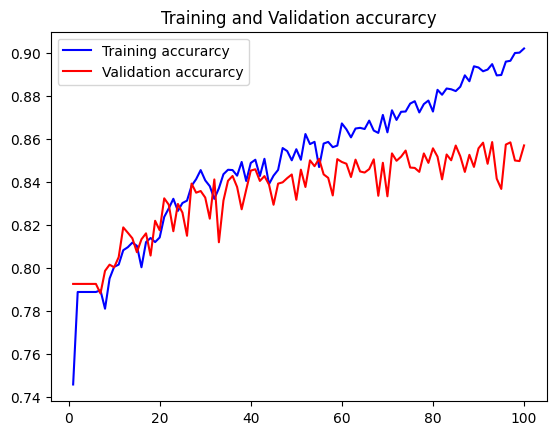

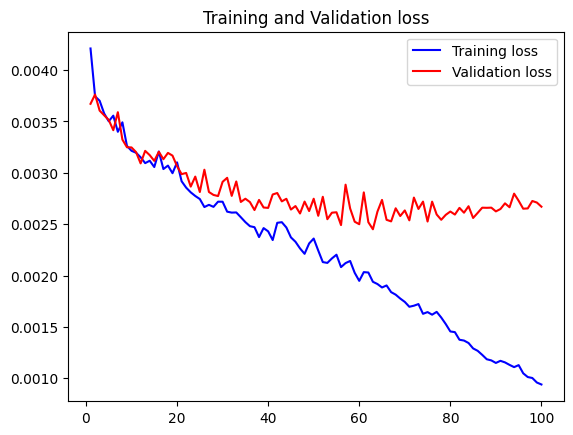

In [63]:
#lets plot the train and val curve
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.title('Training and Validation accurarcy')
plt.legend()
plt.figure()

#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and Validation loss')
plt.legend()
plt.show()

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On fait les mêmes observations que dans le cas précédent.

</div>

### Sauvegarde du modèle

In [64]:
stacked_autoencoder_YCbCr.save('stacked_autoencoder_YCbCr.keras')

### Prédictions sur l'ensemble de test

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On fait des prédictions sur l'ensemble de test :

</div>

In [65]:
test_datagen = ImageDataGenerator()
pred_YCbCr = []

for i, batch in enumerate(test_datagen.flow(X_test_YCbCr, batch_size=1, shuffle=False)):
    pred_YCbCr.append(stacked_autoencoder_YCbCr.predict(batch))

    # Stopper la boucle lorsque toutes les images ont été traitées
    if i >= len(X_test_YCbCr) - 1:
        break

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━

In [66]:
pred_YCbCr = [np.squeeze(pred_YCbCr[k], axis=0) for k in range(len(pred_YCbCr))]

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On reconstruit les images : passage dans l'espace colorimétrique RGB.

</div>

In [67]:
n = 0

with tqdm(pred_YCbCr, desc="Reconstruction", unit="image") as pbar:
    for prediction in pbar:

        Cr_reconstructed = np.expand_dims((prediction[:,:,0] * 255).astype(np.uint8), axis=-1)
        Cb_reconstructed = np.expand_dims((prediction[:,:,1] * 255).astype(np.uint8), axis=-1)
        Y_reconstructed = (X_test_YCbCr[n] * 255).astype(np.uint8)

        # Recombinaison des canaux
        image_ycbcr_pred = cv2.merge([Y_reconstructed, Cr_reconstructed, Cb_reconstructed])

        # Convertion en RGB
        image_rgb_pred = cv2.cvtColor(image_ycbcr_pred, cv2.COLOR_YCrCb2RGB)

        pred_YCbCr[n] = image_rgb_pred

        n += 1

Reconstruction: 100%|██████████| 150/150 [00:00<00:00, 2430.00image/s]


### Enregistrement des nouveaux sets et prédictions

In [68]:
# data = {"X_train_YCbCr": X_train_YCbCr, "Y_train_YCbCr": Y_train_YCbCr,
#         "X_val_YCbCr": X_val_YCbCr, "Y_val_YCbCr": Y_val_YCbCr,
#         "X_test_YCbCr": X_test_YCbCr, "Y_test_YCbCr": Y_test_YCbCr,
#         "pred_YCbCr": pred_YCbCr}

# with open("sets_YCbCr.pkl", "wb") as f:
#     pickle.dump(data, f)

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On affiche quelques résultats :

</div>

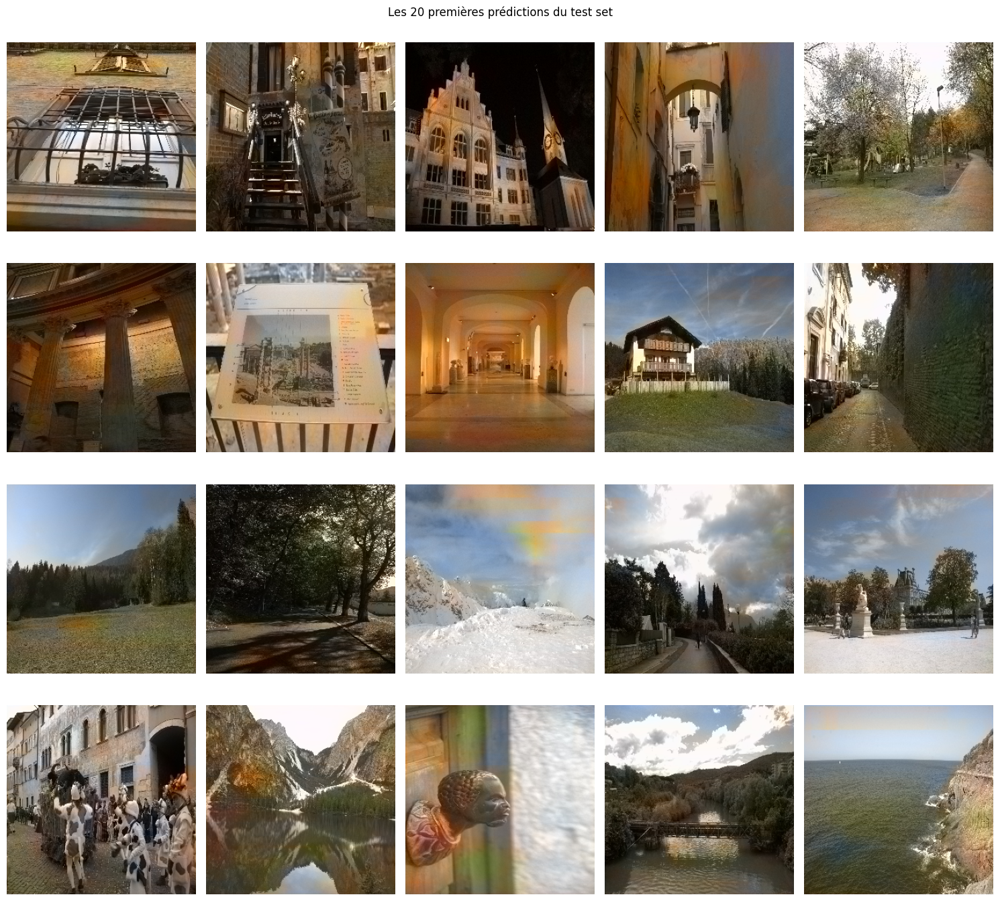

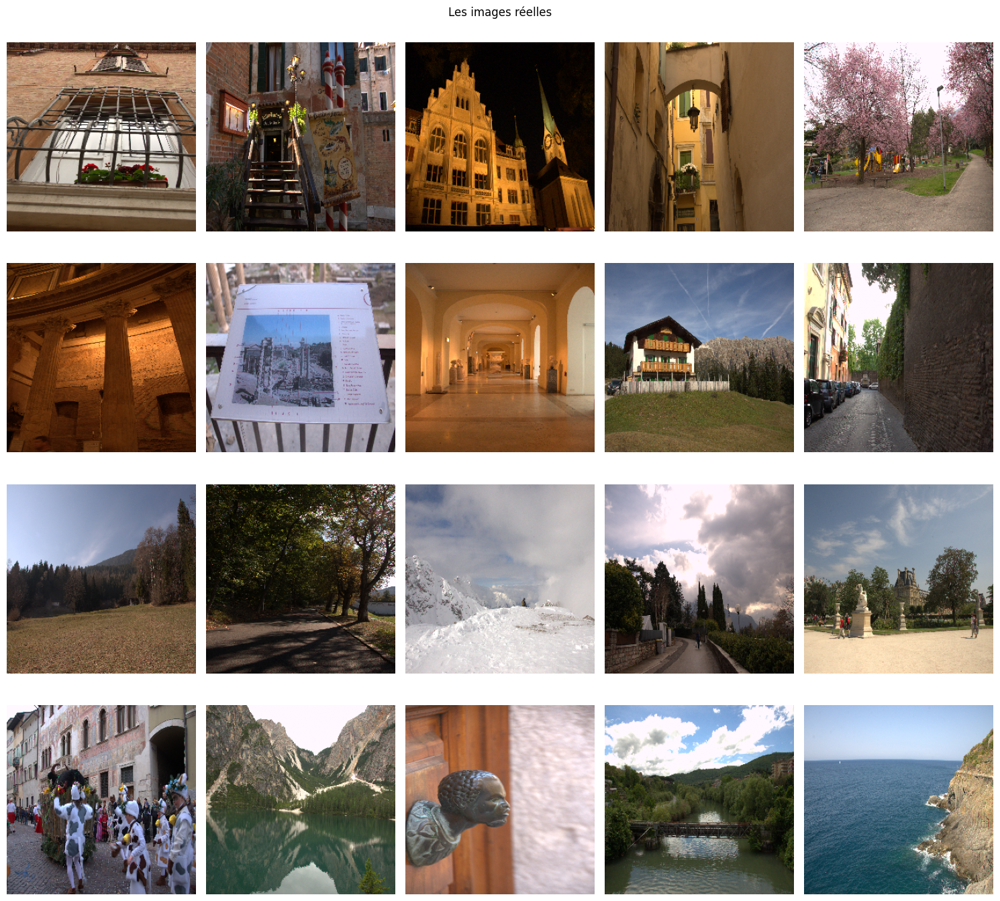

In [69]:
show_examples(pred_YCbCr[:20], "Les 20 premières prédictions du test set")
show_examples(Y_test[:20], "Les images réelles")

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Les résultats sont comparables au cas précédent.

</div>

## Nouvelle base de données : CelebA

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On a choisi de tester une base de donnée plus homogène, ne contenant que des portraits.

Cette base de données est disponible pour des travaux de recherche à but non commercial. Elle est émise par The Chinese University of Hong Kong.

On utilise 5000 images pour l'entraînement, 300 pour la validation et 300 pour le test.

</div>

### Traitement des images

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On utilise le modèle et la préparation des données dans l'espace LAB et on ne redimenssionne pas les images cette fois, qui sont de taille (218, 178) :

</div>

In [129]:
def preprocess(image_path, target_size=(256, 256)):

    # Chargement de l'image
    image = cv2.imread(image_path)

    # Convertion en espace YCbCr
    image_lab = cv2.cvtColor(image, cv2.COLOR_BGR2Lab)
    L_channel, a_channel, b_channel = cv2.split(image_lab)

    # Normalisation des valeurs entre 0 et 1
    # Lors de la conversion d'images 8 bits, la plage de L est multipliée par 255/100, et a et b reçoivent un décalage de 128 pour remplir la plage 8 bits.
    L_channel = L_channel / 255.0 # Version noir et blanc de l'image, donc l'entrée du modèle
    # En soustrayant 128 et en divisant par 128, on centre les valeurs autour de 0 et on les réduit à l'échelle [-1, 1]. 
    # Cela équilibre l'importance des valeurs positives (teintes chaudes ou vertes) et négatives (teintes froides ou rouges).
    a_channel = (a_channel - 128.0) / 128.0 
    b_channel = (b_channel - 128.0) / 128.0
    
    L_channel = np.expand_dims(L_channel, axis=-1)

    return L_channel, np.stack((a_channel, b_channel), axis=-1) 

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On créé des nouveaux ensembles de données :

</div>

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_train_CelebA`, `Y_train_CelebA` :

</div>

In [130]:
folder_path = "CelebA/train"
X_train_CelebA = []
Y_train_CelebA = []

with tqdm(os.listdir(folder_path), desc="Création de X_train_CelebA et Y_train_CelebA", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_train_CelebA.append(X)
        Y_train_CelebA.append(Y)

X_train_CelebA = np.array(X_train_CelebA)
Y_train_CelebA = np.array(Y_train_CelebA)

Création de X_train_CelebA et Y_train_CelebA: 100%|██████████| 5000/5000 [00:22<00:00, 221.63image/s]


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_val_CelebA`, `Y_val_CelebA` :

</div>

In [131]:
folder_path = "CelebA/val"
X_val_CelebA = []
Y_val_CelebA = []

with tqdm(os.listdir(folder_path), desc="Création de X_val_CelebA et Y_val_CelebA", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_val_CelebA.append(X)
        Y_val_CelebA.append(Y)

X_val_CelebA = np.array(X_val_CelebA)
Y_val_CelebA = np.array(Y_val_CelebA)

Création de X_val_CelebA et Y_val_CelebA: 100%|██████████| 300/300 [00:01<00:00, 244.13image/s]


<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

- `X_test_CelebA`, `Y_test_CelebA` :

</div>

In [132]:
folder_path = "CelebA/test"
X_test_CelebA = []
Y_test_CelebA = []

with tqdm(os.listdir(folder_path), desc="Création de X_test_CelebA et Y_test_CelebA", unit="image") as pbar:
    for filename in pbar:

        image_path = os.path.join(folder_path, filename)
        X, Y = preprocess(image_path)
        X_test_CelebA.append(X)
        Y_test_CelebA.append(Y)

X_test_CelebA = np.array(X_test_CelebA)
Y_test_CelebA = np.array(Y_test_CelebA)

Création de X_test_CelebA et Y_test_CelebA: 100%|██████████| 300/300 [00:01<00:00, 203.46image/s]


### Un troisième modèle

In [156]:
encoder = models.Sequential([

    layers.InputLayer(shape=(218, 178, 1)), # Les images sont de taille (256, 256) avec 1 canal (niveaux de gris).
    layers.Conv2D(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    layers.Conv2D(256, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.MaxPool2D(pool_size=2),

    # Couche de "bottleneck"
    layers.Conv2D(512, kernel_size=(3, 3), padding="same", activation="relu")
])

In [157]:
decoder = models.Sequential([
    layers.Conv2DTranspose(256, kernel_size=(3, 3), padding="same", activation="relu", input_shape=[13, 11, 512]),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(128, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(64, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    layers.Conv2DTranspose(32, kernel_size=(3, 3), padding="same", activation="relu"),
    layers.UpSampling2D(size=2),

    # Dernière couche 
    layers.Conv2DTranspose(2, kernel_size=(3, 3), padding="same", activation="tanh"), # tanh car maintenant les valeurs sont comprises entre -1 et 1
    layers.ZeroPadding2D(((5, 5), (1, 1)))  # Ajuste à (218, 178)
])

In [158]:
stacked_autoencoder_CelebA = models.Sequential([encoder, decoder])

In [159]:
stacked_autoencoder_CelebA.summary()

Model: "sequential_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_36 (Sequential)      │ (None, 13, 11, 512)    │     1,568,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_37 (Sequential)      │ (None, 218, 178, 2)    │     1,567,778 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,135,778 (11.96 MB)

 Trainable params: 3,135,778 (11.96 MB)

 Non-trainable params: 0 (0.00 B)

In [160]:
stacked_autoencoder_CelebA.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

In [161]:
batch_size = 50
ntrain = len(X_train_CelebA)
nval = len(X_val_CelebA)

train_datagen = ImageDataGenerator() 
val_datagen = ImageDataGenerator() # On ne fait pas d'augmentation

#On créé les générateurs d'images
train_generator = train_datagen.flow(X_train_CelebA, Y_train_CelebA, batch_size=batch_size)
val_generator = val_datagen.flow(X_val_CelebA, Y_val_CelebA, batch_size=batch_size)

### Entraînement du modèle

In [162]:
history = stacked_autoencoder_CelebA.fit(train_generator,
                                steps_per_epoch=ntrain // batch_size,
                                epochs=100,
                                validation_data=val_generator,
                                validation_steps=nval // batch_size)

Epoch 1/100


c:\Python310\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


100/100 ━━━━━━━━━━━━━━━━━━━━ 201s 2s/step - accuracy: 0.5634 - loss: 0.0112 - val_accuracy: 0.5831 - val_loss: 0.0082
Epoch 2/100
100/100 ━━━━━━━━━━━━━━━━━━━━ 188s 2s/step - accuracy: 0.5977 - loss: 0.0086 - val_accuracy: 0.5901 - val_loss: 0.0081
Epoch 3/100
100/100 ━━━━━━━━━━━━━━━━━━━━ 202s 2s/step - accuracy: 0.6065 - loss: 0.0088 - val_accuracy: 0.6007 - val_loss: 0.0077
Epoch 4/100
100/100 ━━━━━━━━━━━━━━━━━━━━ 174s 2s/step - accuracy: 0.6065 - loss: 0.0080 - val_accuracy: 0.5858 - val_loss: 0.0077
Epoch 5/100
100/100 ━━━━━━━━━━━━━━━━━━━━ 146s 1s/step - accuracy: 0.6110 - loss: 0.0081 - val_accuracy: 0.5783 - val_loss: 0.0078
Epoch 6/100
100/100 ━━━━━━━━━━━━━━━━━━━━ 143s 1s/step - accuracy: 0.6073 - loss: 0.0079 - val_accuracy: 0.6063 - val_loss: 0.0076
Epoch 7/100
100/100 ━━━━━━━━━━━━━━━━━━━━ 141s 1s/step - accuracy: 0.6119 - loss: 0.0081 - val_accuracy: 0.6099 - val_loss: 0.0075
Epoch 8/100
100/100 ━━━━━━━━━━━━━━━━━━━━ 138s 1s/step - accuracy: 0.6120 - loss: 0.0078 - val_accuracy

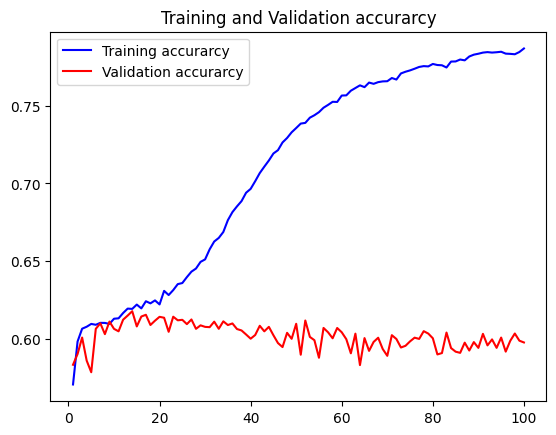

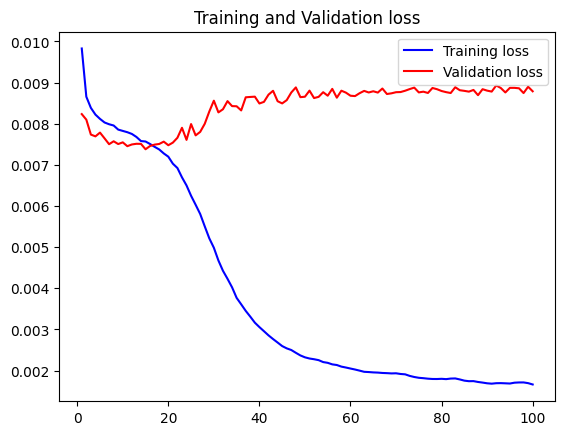

In [163]:
#lets plot the train and val curve
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.title('Training and Validation accurarcy')
plt.legend()
plt.figure()

#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and Validation loss')
plt.legend()
plt.show()

### Sauvegarde du modèle

In [164]:
stacked_autoencoder_CelebA.save('stacked_autoencoder_CelebA.keras')

### Prédictions sur l'ensemble de test

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On fait des prédictions sur l'ensemble de test : 

</div>

In [180]:
test_datagen = ImageDataGenerator()
pred_CelebA = []

for i, batch in enumerate(test_datagen.flow(X_test_CelebA, batch_size=1, shuffle=False)):
    pred_CelebA.append(stacked_autoencoder_CelebA.predict(batch))

    # Stopper la boucle lorsque toutes les images ont été traitées
    if i >= len(X_test_CelebA) - 1:
        break

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On reconstruit les images (passage de LAB vers RGB) :

</div>

In [181]:
pred_CelebA = [np.squeeze(pred_CelebA[k], axis=0) for k in range(len(pred_CelebA))]

In [182]:
n = 0

with tqdm(pred_CelebA, desc="Reconstruction", unit="image") as pbar:
    for prediction in pbar:

        a_reconstructed = np.expand_dims(((prediction[:,:,0] * 128) + 128).astype(np.uint8), axis=-1)
        b_reconstructed = np.expand_dims(((prediction[:,:,1] * 128) + 128).astype(np.uint8), axis=-1)
        L_reconstructed = (X_test_CelebA[n] * 255).astype(np.uint8)

        # Recombinaison des canaux
        image_lab_pred = cv2.merge([L_reconstructed, a_reconstructed, b_reconstructed])

        # Convertion en RGB
        image_rgb_pred = cv2.cvtColor(image_lab_pred, cv2.COLOR_LAB2RGB)

        pred_CelebA[n] = image_rgb_pred

        n += 1

Reconstruction: 100%|██████████| 300/300 [00:00<00:00, 444.53image/s]


### Enregistrement des nouveaux sets et prédictions

In [183]:
# data = {"X_train_CelebA": X_train_CelebA, "Y_train_CelebA": Y_train_CelebA,
#         "X_val_CelebA": X_val_CelebA, "Y_val_CelebA": Y_val_CelebA,
#         "X_test_CelebA": X_test_CelebA, "Y_test_CelebA": Y_test_CelebA,
#         "pred_CelebA": pred_CelebA}

# with open("sets_CelebA.pkl", "wb") as f:
#     pickle.dump(data, f)

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On affiche quelques résultats :

</div>

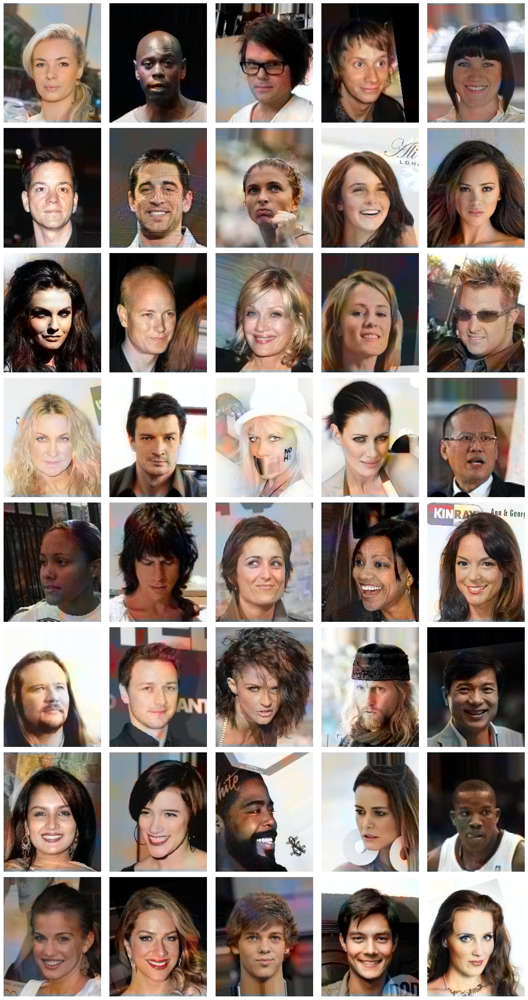

In [195]:
show_examples(pred_CelebA[:40])

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

On observe toujours quelques artéfactes de couleurs. Cependant, malgré le fait qu'on observe un net sur apprentisage, les résultats sur les portraits test (cheveux et couleur de peau) sont géréralement assez bons.
La divergence entre les courbes peut être expliquée par au moins trois facteurs :
- La tâche de colorisation est subjective, c'est un problème créatif et certains artefacts de couleur sont tolérés. Si la colorisation des cheveux et de la peau est correcte, c'est un signe que le modèle capte les grandes structures de l'image, même si la perte ne diminue pas drastiquement pour la validation. 
- Le dataset (5000 images d'entraînement) n'est peut-être toujours pas suffisamment grand pour obtenir des résultats réellement satisfaisants mais nous sommes limités par la mémoire et le temps de calcul (333min d'entraînement ici).
- Peut-être que la prochaine piste d'amélioration est l'amélioration du modèle.

</div>

## Modèle U-Net

In [ ]:
def unet(input_shape=(256, 256, 1)):
    # Encodeur (partie contractante)
    inputs = layers.Input(input_shape)

    conv1 = layers.Conv2D(32, (3, 3), padding="same", activation="relu")(inputs)
    conv1 = layers.Conv2D(32, (3, 3), padding="same", activation="relu")(conv1)
    pool1 = layers.MaxPool2D(pool_size=2)(conv1)

    conv2 = layers.Conv2D(64, (3, 3), padding="same", activation="relu")(pool1)
    conv2 = layers.Conv2D(64, (3, 3), padding="same", activation="relu")(conv2)
    pool2 = layers.MaxPool2D(pool_size=2)(conv2)

    conv3 = layers.Conv2D(128, (3, 3), padding="same", activation="relu")(pool2)
    conv3 = layers.Conv2D(128, (3, 3), padding="same", activation="relu")(conv3)
    pool3 = layers.MaxPool2D(pool_size=2)(conv3)

    conv4 = layers.Conv2D(256, (3, 3), padding="same", activation="relu")(pool3)
    conv4 = layers.Conv2D(256, (3, 3), padding="same", activation="relu")(conv4)
    pool4 = layers.MaxPool2D(pool_size=2)(conv4)

    conv5 = layers.Conv2D(512, (3, 3), padding="same", activation="relu")(pool4)

    # Décodeur (partie expansible avec skip connections)
    up1 = layers.UpSampling2D(size=2)(conv5)
    up1 = layers.Conv2DTranspose(256, (3, 3), padding="same", activation="relu")(up1)
    merge1 = layers.concatenate([up1, conv4], axis=-1)
    conv6 = layers.Conv2D(256, (3, 3), padding="same", activation="relu")(merge1)
    conv6 = layers.Conv2D(256, (3, 3), padding="same", activation="relu")(conv6)

    up2 = layers.UpSampling2D(size=2)(conv6)
    up2 = layers.Conv2DTranspose(128, (3, 3), padding="same", activation="relu")(up2)
    merge2 = layers.concatenate([up2, conv3], axis=-1)
    conv7 = layers.Conv2D(128, (3, 3), padding="same", activation="relu")(merge2)
    conv7 = layers.Conv2D(128, (3, 3), padding="same", activation="relu")(conv7)

    up3 = layers.UpSampling2D(size=2)(conv7)
    up3 = layers.Conv2DTranspose(64, (3, 3), padding="same", activation="relu")(up3)
    merge3 = layers.concatenate([up3, conv2], axis=-1)
    conv8 = layers.Conv2D(64, (3, 3), padding="same", activation="relu")(merge3)
    conv8 = layers.Conv2D(64, (3, 3), padding="same", activation="relu")(conv8)

    up4 = layers.UpSampling2D(size=2)(conv8)
    up4 = layers.Conv2DTranspose(32, (3, 3), padding="same", activation="relu")(up4)
    merge4 = layers.concatenate([up4, conv1], axis=-1)
    conv9 = layers.Conv2D(32, (3, 3), padding="same", activation="relu")(merge4)
    conv9 = layers.Conv2D(32, (3, 3), padding="same", activation="relu")(conv9)

    # Couche de sortie 
    output = layers.Conv2D(2, (3, 3), padding="same", activation="tanh")(conv9)

    # L modèle
    model = models.Model(inputs, output)
    return model

In [ ]:
model_unet = unet(input_shape=(256, 256, 1))
model_unet.summary()

## Bibliographie

<div style="background-color: rgba(255, 255, 0, 0.15); padding: 8px;">

Biblio :
- http://archives.univ-biskra.dz/bitstream/123456789/27708/1/BOUREBATE_Hamza.pdf
- https://arxiv.org/pdf/1505.04597
</div>